# activate uv env
source .venv/bin/activate
1. srun --account cortex -q cortex_high --nodes=1 --ntasks-per-node=1 --gpus-per-node=1 --cpus-per-task=12 --mem=1024G --time-min=300 --pty /bin/bash
2. jupyter-notebook --port 8899 --ip 0.0.0.0

In [1]:
import dataclasses

import jax

from openpi.models import model as _model
from openpi.policies import droid_policy
from openpi.policies import policy_config as _policy_config
from openpi.shared import download
from openpi.training import config as _config
from openpi.training import data_loader as _data_loader

# Policy inference

The following example shows how to create a policy from a checkpoint and run inference on a dummy example.

In [2]:
config = _config.get_config("pi0_fast_droid")
checkpoint_dir = download.maybe_download("s3://openpi-assets/checkpoints/pi0_fast_droid")

# Create a trained policy.
policy = _policy_config.create_trained_policy(config, checkpoint_dir)

# Run inference on a dummy example. This example corresponds to observations produced by the DROID runtime.
example = droid_policy.make_droid_example()
result = policy.infer(example)

# Delete the policy to free up memory.
del policy

print("Actions shape:", result["actions"].shape)

Some kwargs in processor config are unused and will not have any effect: scale, time_horizon, min_token, vocab_size, action_dim. 
Some kwargs in processor config are unused and will not have any effect: scale, time_horizon, min_token, vocab_size, action_dim. 


Actions shape: (10, 8)


In [3]:
config = _config.get_config("pi0_droid")
checkpoint_dir = download.maybe_download("s3://openpi-assets/checkpoints/pi0_droid")

# Create a trained policy.
policy = _policy_config.create_trained_policy(config, checkpoint_dir)

# Run inference on a dummy example. This example corresponds to observations produced by the DROID runtime.
example = droid_policy.make_droid_example()
result = policy.infer(example)

# Delete the policy to free up memory.
del policy

print("Actions shape:", result["actions"].shape)

Actions shape: (10, 8)


# load droid dataset

In [3]:
import h5py
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

def load_full_droid_episode(episode_path):
    """
    Load all image views and action information from a DROID episode.

    Args:
        episode_path (str): Path to the episode.h5 file

    Returns:
        dict: Contains all images, all action types, and language instructions
    """
    with h5py.File(episode_path, 'r') as f:
        obs = f['episode_data/observation']

        # Load all image views
        img_wrist = obs['wrist_image_left'][:]                  # (T, H, W, 3)
        img_ext1 = obs['exterior_image_1_left'][:]              # (T, H, W, 3)
        img_ext2 = obs['exterior_image_2_left'][:]              # (T, H, W, 3)

        # Load all available actions
        actions = {
            'action': f['episode_data/action'][:]
        }
        action_dict = f['episode_data/action_dict']
        for k in action_dict.keys():
            actions[k] = action_dict[k][:]

        # Load all language instructions
        lang_keys = [k for k in f['episode_metadata'].keys() if k.startswith('language_instruction')]
        language = [f['episode_metadata'][k][()].decode('utf-8') for k in sorted(lang_keys)]

    return {
        'wrist': img_wrist,
        'ext1': img_ext1,
        'ext2': img_ext2,
        'actions': actions,
        'language': language
    }

# Load the episode
# episode_path = "/fsx-cortex-datacache/shared/datasets/droid/011825/droid_h5/RAD/success/2023-08-31/Thu_Aug_31_17:53:55_2023/episode.h5"
episode_path = "/fsx-cortex-datacache/shared/datasets/droid/011825/droid_h5/RAD/success/2023-08-31/Thu_Aug_31_18:29:52_2023/episode.h5"
ep_data = load_full_droid_episode(episode_path)




# load MPK dataset

In [2]:
import h5py
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML



def load_full_mpk_episode(episode_path):
    """
    Load all image views and action information from a MPK episode.

    Args:
        episode_path (str): Path to the episode.h5 file

    Returns:
        dict: Contains all images, all action types, and language instructions
    """
    with h5py.File(episode_path, 'r') as f:
        obs = f['episode_data/observation']

        # Load all image views
        img_wrist = obs['wrist_image_left'][:]                  # (T, H, W, 3)
        img_ext1 = obs['exterior_image_1_left'][:]              # (T, H, W, 3)
        img_ext2 = obs['exterior_image_2_left'][:]              # (T, H, W, 3)
        joint_pos = obs['joint_position'][:]                    # (T, 7)
        gripper_pos = obs['gripper_position'][:].reshape(-1, 1) # (T, 1)

        # # Load all available actions
        # actions = {
        #     'action': f['episode_data/action'][:]
        # }
        # action_dict = f['episode_data/action_dict']
        # for k in action_dict.keys():
        #     actions[k] = action_dict[k][:]

        # # Load all language instructions
        # lang_keys = [k for k in f['episode_metadata'].keys() if k.startswith('language_instruction')]
        # language = [f['episode_metadata'][k][()].decode('utf-8') for k in sorted(lang_keys)]

    return {
        'wrist': img_wrist,
        'ext1': img_ext1,
        'ext2': img_ext2,
        'joint_pos': joint_pos,
        'gripper_pos': gripper_pos,
        # 'actions': actions,
        # 'language': language
    }


episode_path = "/home/hanchencui/projects/robot_world_models/output_wrist.h5"
ep_data = load_full_mpk_episode(episode_path)

KeyError: "Unable to synchronously open object (object 'wrist_image_left' doesn't exist)"

dataset video 

In [4]:
from IPython.display import Image
# Concatenate frames horizontally: [wrist | exterior 1 | exterior 2]
frames = []
for i in range(ep_data['wrist'].shape[0]):
    frame = np.concatenate([
        ep_data['wrist'][i],
        ep_data['ext1'][i],
        ep_data['ext2'][i]
    ], axis=1)
    frames.append(frame)

# Plot animation using matplotlib
fig, ax = plt.subplots(figsize=(12, 4))
im = ax.imshow(frames[0])
ax.axis('off')
plt.title("Wrist | Exterior 1 | Exterior 2")
plt.subplots_adjust(left=0, right=1, top=1, bottom=0)

def update(i):
    im.set_data(frames[i])
    return [im]

ani = animation.FuncAnimation(fig, update, frames=len(frames), interval=100)
plt.close()  # Prevent double display in Jupyter

# Show the animation directly in notebook
HTML(ani.to_jshtml())
# ani.save("episode_animation.gif", writer='pillow', fps=10)


In [27]:
ani.save("episode_animation.gif", writer='pillow', fps=10)

dataset information

In [4]:
import h5py

def print_h5_structure(file_path):
    def print_attrs(name, obj):
        if isinstance(obj, h5py.Dataset):
            print(f"[Dataset] {name}, shape: {obj.shape}, dtype: {obj.dtype}")
        elif isinstance(obj, h5py.Group):
            print(f"[Group]   {name}")

    with h5py.File(file_path, 'r') as f:
        print(f"\nStructure of: {file_path}")
        f.visititems(print_attrs)


# file_path = "/fsx-cortex-datacache/shared/datasets/droid/011825/droid_h5/RAD/success/2023-08-31/Thu_Aug_31_17:53:55_2023/episode.h5"
# file_path = "/fsx-cortex-datacache/shared/datasets/droid/011825/droid_h5/RAD/success/2023-08-31/Thu_Aug_31_18:29:52_2023/episode.h5"
file_path = "/home/hanchencui/projects/robot_world_models/output_wrist.h5"
print_h5_structure(file_path)



Structure of: /home/hanchencui/projects/robot_world_models/output_wrist.h5
[Group]   episode_data
[Group]   episode_data/observation
[Dataset] episode_data/observation/cartesian_position, shape: (117, 6), dtype: float64
[Dataset] episode_data/observation/exterior_image_1_left, shape: (117, 480, 640, 3), dtype: uint8
[Dataset] episode_data/observation/exterior_image_2_left, shape: (117, 480, 640, 3), dtype: uint8
[Dataset] episode_data/observation/gripper_position, shape: (117,), dtype: float64
[Dataset] episode_data/observation/joint_position, shape: (117, 7), dtype: float64
[Dataset] episode_data/observation/wrist_image_left, shape: (117, 480, 640, 3), dtype: uint8


# Running Inference for a Pre-Trained Model in droid

In [5]:
import numpy as np
from tqdm import tqdm
import cv2

from openpi.training import config
from openpi.policies import policy_config
from openpi.shared import download

# # droid pi fast policy
config = config.get_config("pi0_fast_droid")
checkpoint_dir = download.maybe_download("s3://openpi-assets/checkpoints/pi0_fast_droid")

# droid pi policy
# config = config.get_config("pi0_droid")
# checkpoint_dir = download.maybe_download("s3://openpi-assets/checkpoints/pi0_droid")


# Create a trained policy.
policy = policy_config.create_trained_policy(config, checkpoint_dir)


#  Load the episode data
episode_path = "/fsx-cortex-datacache/shared/datasets/droid/011825/droid_h5/RAD/success/2023-08-31/Thu_Aug_31_18:29:52_2023/episode.h5"
ep_data = load_full_droid_episode(episode_path)

#  Extract relevant data from the episode
wrist_imgs = ep_data['wrist']                    # (T, H, W, 3)
ext1_imgs = ep_data['ext1']
joint_pos = ep_data['actions']['joint_position']      # (T, 7)
gripper_pos = ep_data['actions']['gripper_position']  # (T, 1)
gt_joint_vel = ep_data['actions']['joint_velocity']  # (T, 7)
gt_gripper_vel = ep_data['actions']['gripper_velocity']  # (T, 1)
prompt = ep_data['language'][0]                  #  use the first language instruction

T = wrist_imgs.shape[0]
#  Iterate through each time step and prepare the example for inference


ROUND = 1
pred_joint_vel_buffer = []
pred_gripper_vel_buffer = []
for i in range(ROUND):
    pred_joint_vel = []
    pred_gripper_vel = []
    for t in tqdm(range(T)):
        example = {
            "observation/exterior_image_1_left": cv2.resize(ext1_imgs[t], (224, 224)),
            "observation/wrist_image_left": cv2.resize(wrist_imgs[t], (224, 224)),
            "observation/joint_position": joint_pos[t],
            "observation/gripper_position": gripper_pos[t],
            "prompt": prompt
        }

        chunk = policy.infer(example)["actions"]  # (chunk_size, 8)
        action = chunk[0]                         # (8,)

        pred_joint_vel.append(action[:7])
        pred_gripper_vel.append(action[7])

    pred_joint_vel = np.stack(pred_joint_vel)         # (T, 7)
    pred_gripper_vel = np.stack(pred_gripper_vel)     # (T,)
    pred_joint_vel_buffer.append(pred_joint_vel)
    pred_gripper_vel_buffer.append(pred_gripper_vel)

Some kwargs in processor config are unused and will not have any effect: min_token, action_dim, scale, vocab_size, time_horizon. 
Some kwargs in processor config are unused and will not have any effect: min_token, action_dim, scale, vocab_size, time_horizon. 
 18%|██████████████████████████████▌                                                                                                                                          | 70/387 [00:51<01:17,  4.09it/s]

Error decoding tokens: cannot reshape array of size 78 into shape (8)
Tokens: [458, 303, 1131, 749, 345, 417, 335, 1628, 261, 260]


 18%|███████████████████████████████                                                                                                                                          | 71/387 [00:51<01:16,  4.12it/s]

Error decoding tokens: cannot reshape array of size 78 into shape (8)
Tokens: [382, 308, 302, 1060, 479, 525, 335, 1628, 261, 260]


 19%|████████████████████████████████▊                                                                                                                                        | 75/387 [00:52<01:20,  3.88it/s]

Error decoding tokens: cannot reshape array of size 78 into shape (8)
Tokens: [324, 308, 1585, 389, 1004, 292, 403, 395, 311, 530, 261, 260]


 20%|█████████████████████████████████▏                                                                                                                                       | 76/387 [00:53<01:21,  3.83it/s]

Error decoding tokens: cannot reshape array of size 78 into shape (8)
Tokens: [354, 314, 1574, 405, 829, 292, 311, 360, 552, 1413, 530, 261, 259]


 20%|█████████████████████████████████▋                                                                                                                                       | 77/387 [00:53<01:21,  3.79it/s]

Error decoding tokens: cannot reshape array of size 78 into shape (8)
Tokens: [354, 1403, 300, 409, 829, 310, 274, 360, 279, 530, 530, 261, 259]


 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 322/387 [02:02<00:17,  3.81it/s]

Error decoding tokens: cannot reshape array of size 78 into shape (8)
Tokens: [295, 314, 299, 321, 302, 398, 360, 679, 258, 875, 1374, 530, 539, 530, 515, 530]


 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                           | 325/387 [02:03<00:17,  3.55it/s]

Error decoding tokens: cannot reshape array of size 78 into shape (8)
Tokens: [299, 314, 299, 321, 303, 371, 273, 380, 725, 258, 875, 539, 515, 530, 267]


 86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 333/387 [02:05<00:14,  3.61it/s]

Error decoding tokens: cannot reshape array of size 78 into shape (8)
Tokens: [295, 314, 299, 321, 302, 371, 273, 380, 725, 258, 875, 539, 515, 530, 267]


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 387/387 [02:20<00:00,  2.76it/s]


# eval MPK data

In [20]:
import numpy as np
from tqdm import tqdm
import cv2

from openpi.training import config
from openpi.policies import policy_config
from openpi.shared import download

# # droid fast policy
# config = config.get_config("pi0_fast_droid")
# checkpoint_dir = download.maybe_download("s3://openpi-assets/checkpoints/pi0_fast_droid")

# droid policy
config = config.get_config("pi0_droid")
checkpoint_dir = download.maybe_download("s3://openpi-assets/checkpoints/pi0_droid")

# Create a trained policy.
policy = policy_config.create_trained_policy(config, checkpoint_dir)


#  Load the episode data
episode_path = "/home/hanchencui/projects/robot_world_models/output_wrist.h5"
ep_data = load_full_mpk_episode(episode_path)

#  Extract relevant data from the episode
wrist_imgs = ep_data['wrist']                    # (T, H, W, 3)
ext1_imgs = ep_data['ext1']
ext2_imgs = ep_data['ext2']
joint_pos = ep_data['joint_pos']                    # (T, 7)
gripper_pos = ep_data['gripper_pos']                # (T, 1)
prompt = "push the brown "

T = wrist_imgs.shape[0]
#  Iterate through each time step and prepare the example for inference


ROUND = 3
pred_joint_vel_buffer = []
pred_gripper_vel_buffer = []
for i in range(ROUND):
    pred_joint_vel = []
    pred_gripper_vel = []
    for t in tqdm(range(T)):
        example = {
            "observation/exterior_image_1_left": cv2.resize(ext1_imgs[t], (224, 224)),
            "observation/wrist_image_left": cv2.resize(wrist_imgs[t], (224, 224)),
            "observation/joint_position": joint_pos[t],
            "observation/gripper_position": gripper_pos[t],
            "prompt": prompt
        }

        chunk = policy.infer(example)["actions"]  # (chunk_size, 8)
        action = chunk[0]                         # (8,)

        pred_joint_vel.append(action[:7])
        pred_gripper_vel.append(action[7])

    pred_joint_vel = np.stack(pred_joint_vel)         # (T, 7)
    pred_gripper_vel = np.stack(pred_gripper_vel)     # (T,)
    pred_joint_vel_buffer.append(pred_joint_vel)
    pred_gripper_vel_buffer.append(pred_gripper_vel)

100%|███████████████████████████████████████████████████████████████████████████████| 117/117 [00:11<00:00,  9.88it/s]


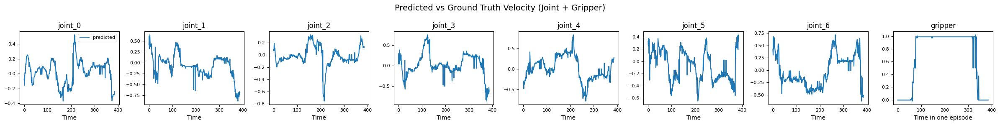

In [6]:
# Plot the predicted joint velocities against ground truth
joint_names = [f"joint_{i}" for i in range(7)]
time = np.arange(T)

fig, axs = plt.subplots(1, 8, figsize=(24, 3))
for j in range(ROUND):
    pred_joint_vel = pred_joint_vel_buffer[j]  # (T, 7)
    pred_gripper_vel = pred_gripper_vel_buffer[j]  # (T,)
    for i in range(7):
        axs[i].plot(time, pred_joint_vel[:, i], label='predicted')
        # if j == 0:
        #     axs[i].plot(time, gt_joint_vel[:, i], label='ground truth')
        axs[i].set_title(joint_names[i])
        axs[i].set_xlabel("Time")
        axs[i].tick_params(labelsize=8)
        if i == 0:
            axs[i].legend(fontsize=8)


    # Plot gripper velocity
    axs[7].plot(time, pred_gripper_vel, label='predicted action')
    # if j == 0:
    #     axs[7].plot(time, gt_gripper_vel[:, 0], label='ground truth')
    axs[7].set_title("gripper")
    axs[7].set_xlabel("Time in one episode")
    axs[7].tick_params(labelsize=8)

fig.suptitle("Predicted vs Ground Truth Velocity (Joint + Gripper)", fontsize=14)
plt.tight_layout()
plt.show()


# analysis
# the predicted joint velocities are kind of noisy, because I only used the first action from each chunk.

# test action distribution given a fixed observation
only compare the first action in a chunk

In [10]:
REPEAT = 100

# T = wrist_imgs.shape[0] # total number of time steps in the episode
t = 25



action_buffer = []
#  Iterate through each time step and prepare the example for inference

for _ in tqdm(range(REPEAT)):
    example = {
        "observation/exterior_image_1_left": cv2.resize(ext1_imgs[t], (224, 224)),
        "observation/wrist_image_left": cv2.resize(wrist_imgs[t], (224, 224)),
        "observation/joint_position": joint_pos[t],
        "observation/gripper_position": gripper_pos[t],
        "prompt": prompt
    }

    chunk = policy.infer(example)["actions"]  # (chunk_size, 8)
    action = chunk[1]                         # (8,)
    action_buffer.append(action)

action_buffer = np.stack(action_buffer)           # (REPEAT, 8)
print(chunk.shape)    

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 100/100 [00:30<00:00,  3.32it/s]

(10, 8)


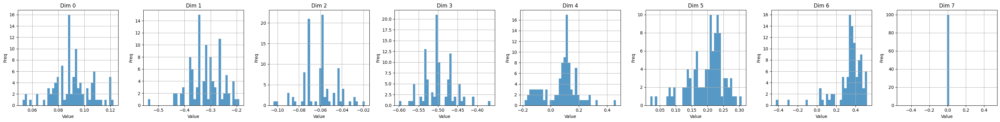

In [12]:
import matplotlib.pyplot as plt


action_dim = action_buffer.shape[1]  # Assuming the action dimension is 8 (7 joint velocities + 1 gripper velocity)
fig, axs = plt.subplots(1, action_dim, figsize=(4 * action_dim, 4))

for i in range(action_dim):
    axs[i].hist(action_buffer[:, i], bins=40, alpha=0.75)
    axs[i].set_title(f"Dim {i}")
    axs[i].set_xlabel("Value")
    axs[i].set_ylabel("Freq")
    # axs[i].set_xlim(-0.5, 0.5)
    axs[i].grid(True)

plt.tight_layout()
plt.show()


# Working with a live model


The following example shows how to create a live model from a checkpoint and compute training loss. First, we are going to demonstrate how to do it with fake data.


In [ ]:
config = _config.get_config("pi0_aloha_sim")

checkpoint_dir = download.maybe_download("s3://openpi-assets/checkpoints/pi0_aloha_sim")
key = jax.random.key(0)

# Create a model from the checkpoint.
model = config.model.load(_model.restore_params(checkpoint_dir / "params"))

# We can create fake observations and actions to test the model.
obs, act = config.model.fake_obs(), config.model.fake_act()

# Sample actions from the model.
loss = model.compute_loss(key, obs, act)
print("Loss shape:", loss.shape)

Now, we are going to create a data loader and use a real batch of training data to compute the loss.

In [ ]:
# Reduce the batch size to reduce memory usage.
config = dataclasses.replace(config, batch_size=2)

# Load a single batch of data. This is the same data that will be used during training.
# NOTE: In order to make this example self-contained, we are skipping the normalization step
# since it requires the normalization statistics to be generated using `compute_norm_stats`.
loader = _data_loader.create_data_loader(config, num_batches=1, skip_norm_stats=True)
obs, act = next(iter(loader))

# Sample actions from the model.
loss = model.compute_loss(key, obs, act)

# Delete the model to free up memory.
del model

print("Loss shape:", loss.shape)

In [ ]:
import h5py
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

def load_full_droid_episode(episode_path):
    """
    Load all image views and action information from a DROID episode.

    Args:
        episode_path (str): Path to the episode.h5 file

    Returns:
        dict: Contains all images, all action types, and language instructions
    """
    with h5py.File(episode_path, 'r') as f:
        obs = f['episode_data/observation']

        # Load all image views
        img_wrist = obs['wrist_image_left'][:]                  # (T, H, W, 3)
        img_ext1 = obs['exterior_image_1_left'][:]              # (T, H, W, 3)
        img_ext2 = obs['exterior_image_2_left'][:]              # (T, H, W, 3)

        # Load all available actions
        actions = {
            'action': f['episode_data/action'][:]
        }
        action_dict = f['episode_data/action_dict']
        for k in action_dict.keys():
            actions[k] = action_dict[k][:]

        # Load all language instructions
        lang_keys = [k for k in f['episode_metadata'].keys() if k.startswith('language_instruction')]
        language = [f['episode_metadata'][k][()].decode('utf-8') for k in sorted(lang_keys)]

    return {
        'wrist': img_wrist,
        'ext1': img_ext1,
        'ext2': img_ext2,
        'actions': actions,
        'language': language
    }

# Load the episode
episode_path = "/fsx-cortex-datacache/shared/datasets/droid/011825/droid_h5/RAD/success/2023-08-31/Thu_Aug_31_17:53:55_2023/episode.h5"
ep_data = load_full_droid_episode(episode_path)

# Concatenate frames horizontally: [wrist | exterior 1 | exterior 2]
frames = []
for i in range(ep_data['wrist'].shape[0]):
    frame = np.concatenate([
        ep_data['wrist'][i],
        ep_data['ext1'][i],
        ep_data['ext2'][i]
    ], axis=1)
    frames.append(frame)

# Plot animation using matplotlib
fig, ax = plt.subplots(figsize=(12, 4))
im = ax.imshow(frames[0])
ax.axis('off')
plt.title("Wrist | Exterior 1 | Exterior 2")

def update(i):
    im.set_data(frames[i])
    return [im]

ani = animation.FuncAnimation(fig, update, frames=len(frames), interval=100)
plt.close()  # Prevent double display in Jupyter

# Show the animation directly in notebook
HTML(ani.to_jshtml())
